In [21]:
import os
import pandas as pd
from wildlife_datasets import datasets

In [22]:
class Horses(datasets.WildlifeDataset):
    def create_catalogue(self) -> pd.DataFrame:
        df = pd.DataFrame({
            'image_id': [1, 2, 3, 4],
            'identity': ['Lukas', 'Vojta', 'Lukas', 'Vojta'],
            'path': ['img1.jpg', 'img2.jpg', 'img3.jpg', 'img4.jpg'],
        })
        return df

In [23]:
class Horses(datasets.WildlifeDataset):
    def create_catalogue(self) -> pd.DataFrame:
        dataset_path = "horse_dataset"
        rows = []
        
        # Walk through the dataset directory
        for horse_name in os.listdir(dataset_path):
            horse_dir = os.path.join(dataset_path, horse_name)
            if os.path.isdir(horse_dir):
                # Process each image in the horse's directory
                for image_file in os.listdir(horse_dir):
                    if image_file.lower().endswith(('.jpeg', '.jpg', '.png')):
                        # Extract image_id from filename (remove extension and horse name)
                        image_id = image_file.rsplit('.', 1)[0]  # Remove extension
                        
                        rows.append({
                            'image_id': image_id,
                            'identity': horse_name,
                            'path': os.path.join(horse_dir, image_file)
                        })
        
        # Create DataFrame from collected rows
        df = pd.DataFrame(rows)
        result = self.finalize_catalogue(df)
        return result

In [24]:
horses = Horses('.')
df = horses.create_catalogue()
print(df)

     image_id identity                                path
0   Cadet_0_0    Cadet  horse_dataset/Cadet/Cadet_0_0.jpeg
1   Cadet_1_0    Cadet  horse_dataset/Cadet/Cadet_1_0.jpeg
2   Cadet_2_0    Cadet  horse_dataset/Cadet/Cadet_2_0.jpeg
3   Cadet_3_0    Cadet  horse_dataset/Cadet/Cadet_3_0.jpeg
4   Cadet_4_0    Cadet  horse_dataset/Cadet/Cadet_4_0.jpeg
..        ...      ...                                 ...
63   Toga_1_2     Toga    horse_dataset/Toga/Toga_1_2.jpeg
64   Toga_1_3     Toga    horse_dataset/Toga/Toga_1_3.jpeg
65   Toga_1_4     Toga    horse_dataset/Toga/Toga_1_4.jpeg
66   Toga_2_0     Toga    horse_dataset/Toga/Toga_2_0.jpeg
67   Toga_2_1     Toga    horse_dataset/Toga/Toga_2_1.jpeg

[68 rows x 3 columns]


Identity: Cadet


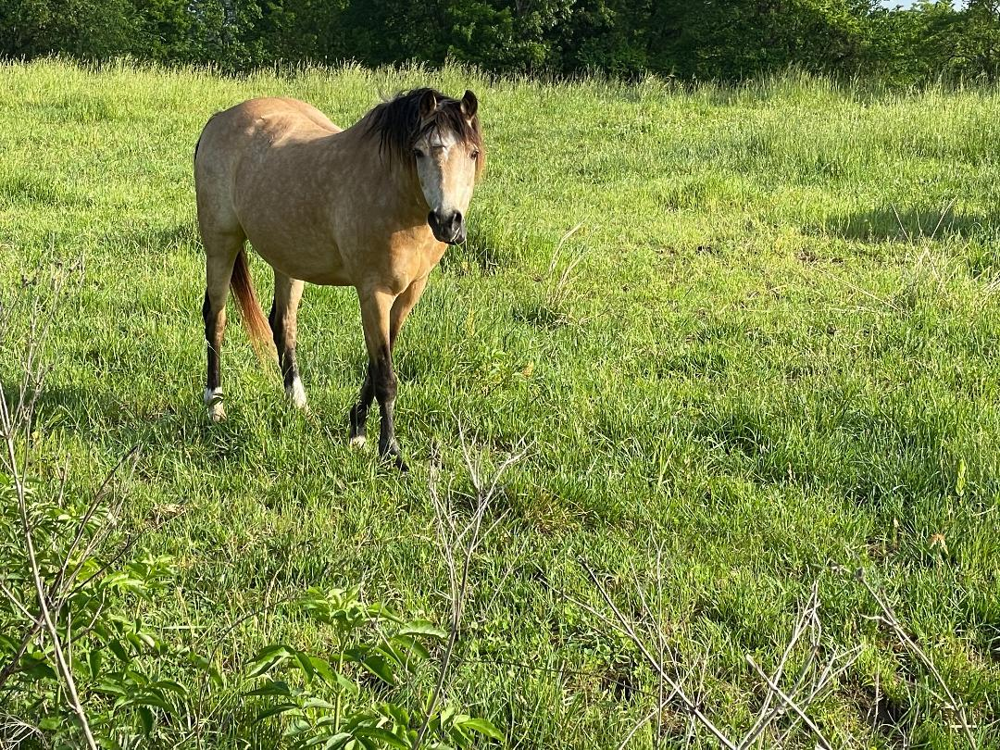

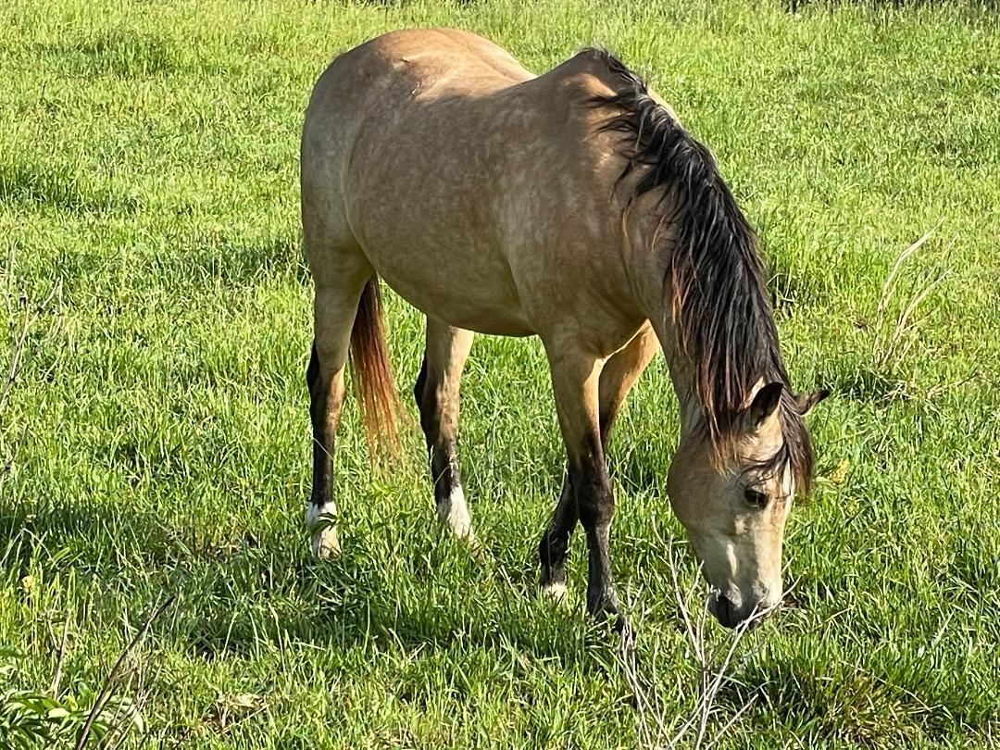

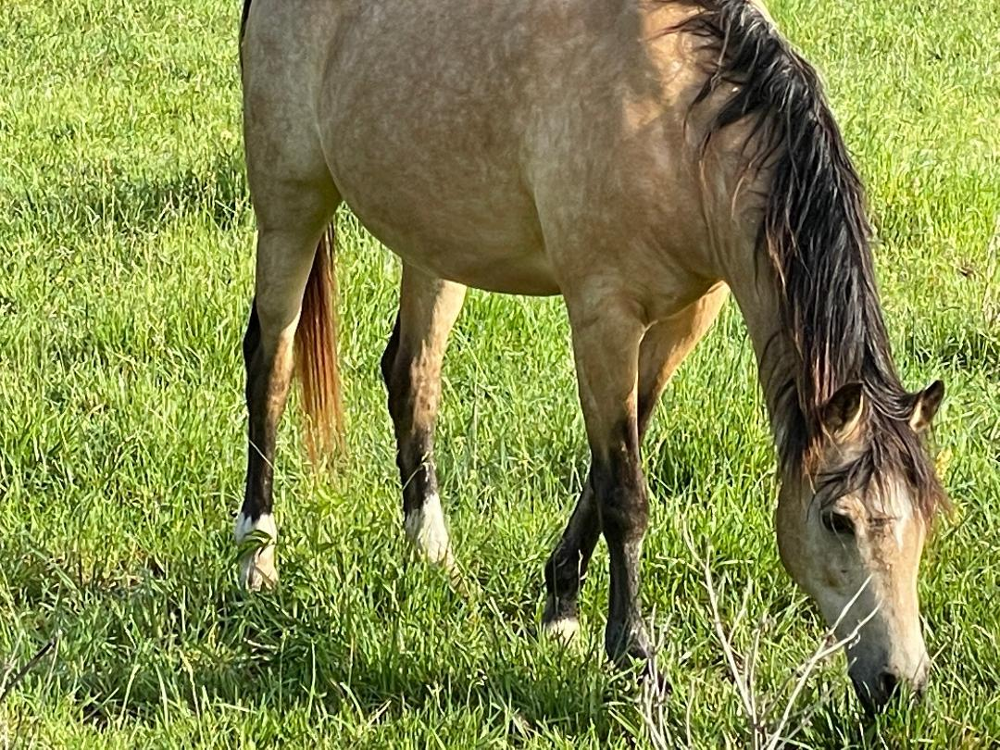

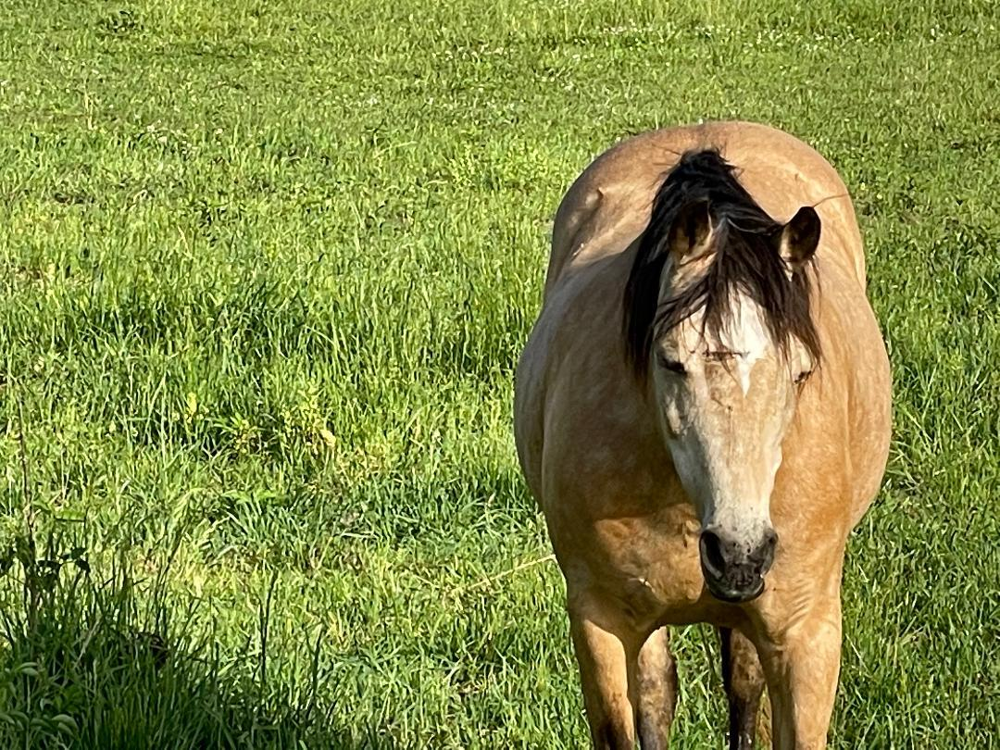

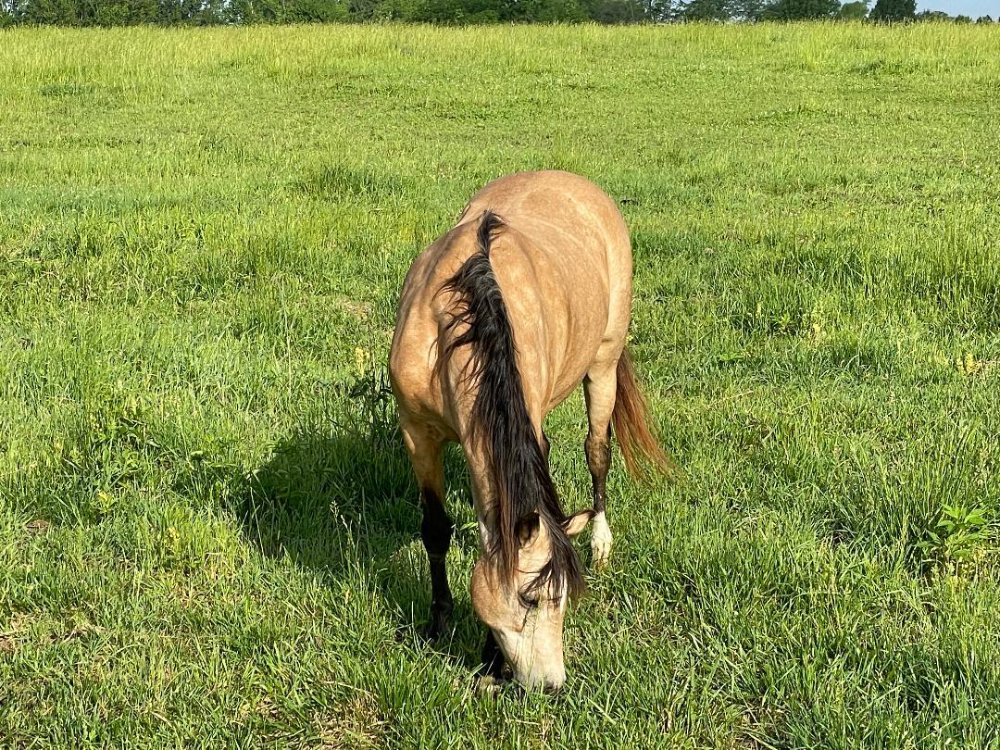

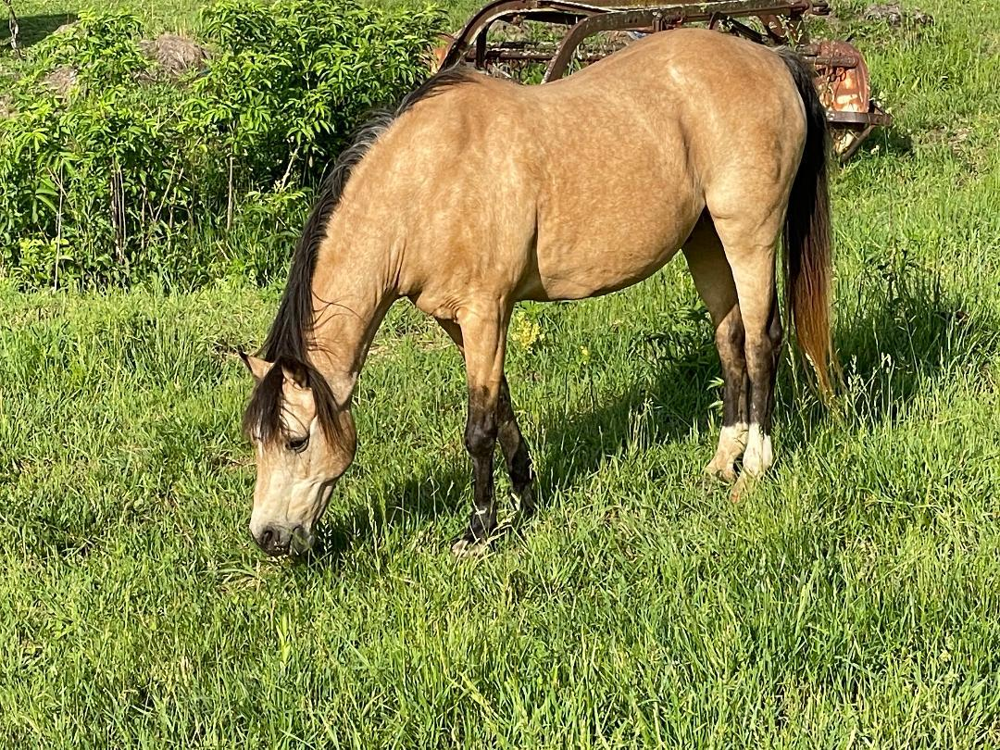

Identity: Cowboy


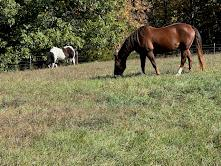

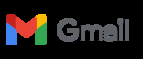

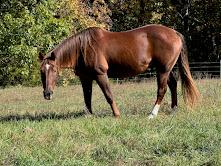

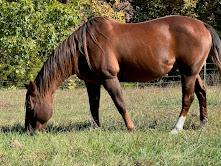

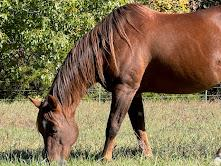

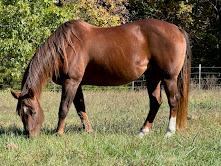

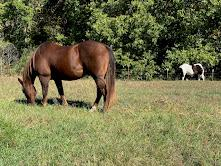

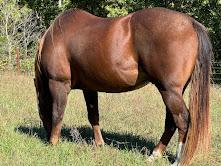

Identity: Dora


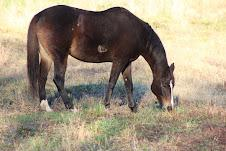

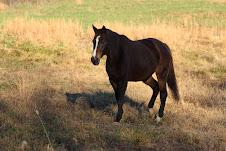

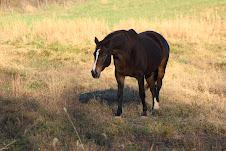

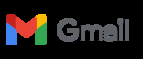

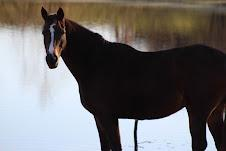

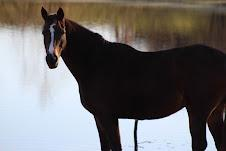

Identity: Ernie


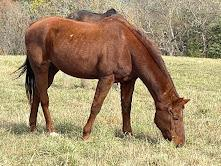

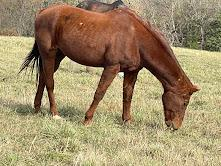

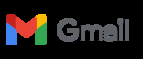

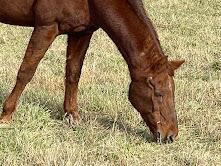

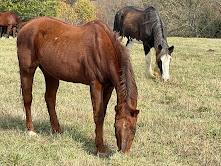

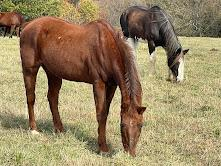

Identity: Jake


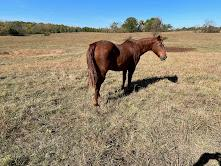

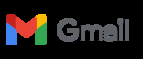

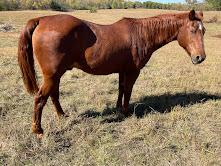

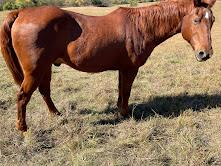

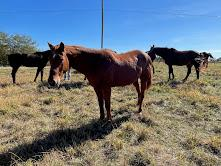

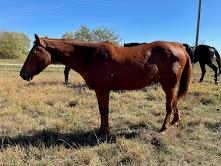

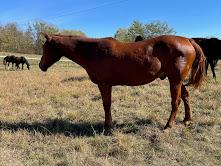

Identity: Martien


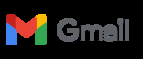

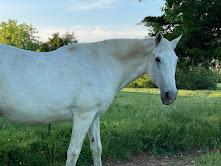

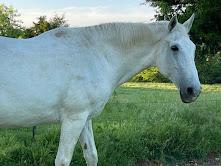

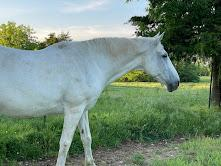

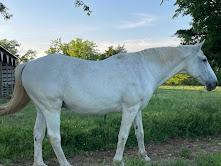

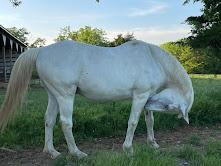

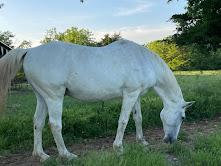

Identity: Moose


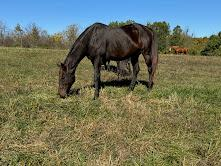

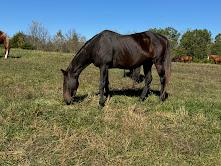

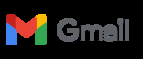

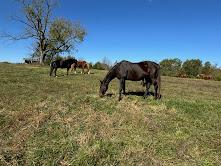

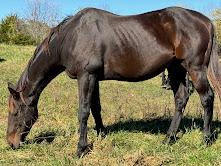

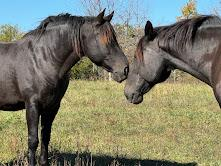

Identity: Pistol


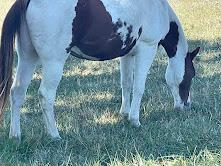

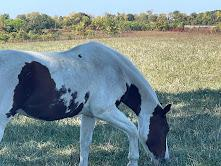

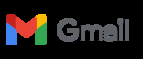

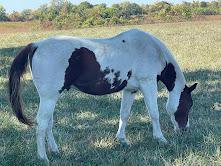

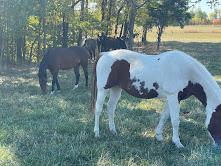

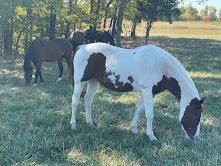

Identity: Pluto


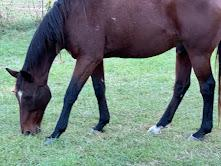

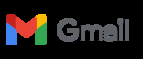

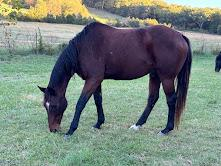

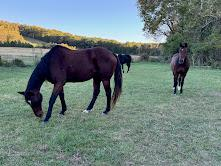

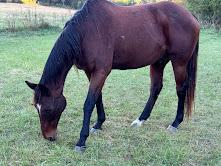

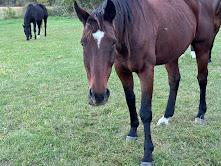

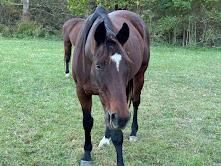

Identity: Toga


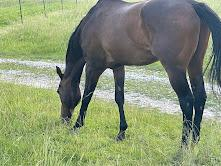

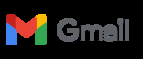

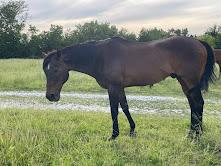

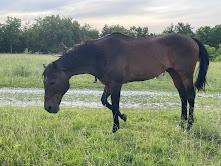

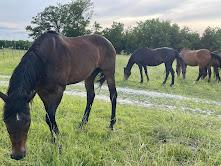

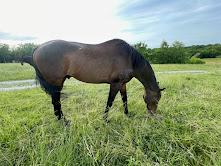

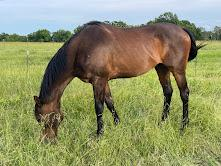

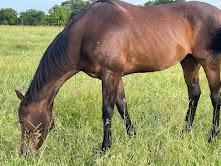

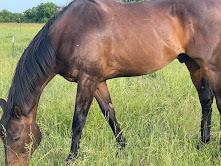

In [25]:
identities = horses.df[['identity']].drop_duplicates()
for identity in identities['identity']:
    print(f"Identity: {identity}")
    for image in horses.get_subset((df['identity'] == identity)):
        display(image)
